  # Topic : Exploring Risk Factors for Diabetes: A Data-Driven Analysis
   
   

### Overview

Diabetes is currently one of the most common and prevalent chronic diseases, leading over time to serious damage to the heart, blood vessels, eyes, kidneys, and nerves. (WHO,2023)According to the World Health Organization (WHO) report, there are 1.5 million deaths directly attributed to diabetes each year.(WHO,2023) With changes in lifestyle and dietary habits, an increasing number of people are affected by this disease. Through data analysis, our aim is to identify the most significant factors contributing to the onset of diabetes with the goal of prevention. This dataset originates from the National Institute of Diabetes and Digestive and Kidney Diseases. Based on this data, we focus on BMI, blood glucose levels, and age, hoping to uncover their associations with diabetes. We will utilize different ML models and choose the best performing model to analyze the relationship among various factors and discover preventive strategies to reduce the future incidence of diabetes.

Data Source : https://www.kaggle.com/datasets/akshaydattatraykhare/diabetes-dataset

#### Features

Pregnancies: Number of times pregnant

Glucose: Plasma glucose concentration a 2 hours in an oral glucose tolerance test

BloodPressure: Diastolic blood pressure (mm Hg)

SkinThickness: Triceps skin fold thickness (mm)

Insulin: 2-Hour serum insulin (mu U/ml)

BMI: Body mass index (weight in kg/(height in m)^2)

DiabetesPedigreeFunction: Diabetes pedigree function

Age: Age (years)

Outcome: Class variable (0 or 1)

#### Data Cleaning and Exploration:
- Checked for null and duplicate values.
- Descriptive statistics and visualizations like box plots, histograms, and pair plots.
- Explored correlations among variables.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly as px
%matplotlib inline
from scipy.stats import norm
from sklearn import tree
from pandas_profiling import ProfileReport

import warnings
warnings.filterwarnings('ignore')

## importing the required libraries

In [2]:
diabetes=pd.read_csv("C:/Users/balaji/Downloads/archive (10)/diabetes.csv")

## Reading the data set and assigning it the variable called diabetes

In [3]:
diabetes.columns

## To display all the column header in the diabetes data

Index(['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome'],
      dtype='object')

In [4]:
diabetes.head()
## To display the 5 enteries in the diabetes data

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1


In [5]:
diabetes.isna().sum()

#adding the na values

Pregnancies                 0
Glucose                     0
BloodPressure               0
SkinThickness               0
Insulin                     0
BMI                         0
DiabetesPedigreeFunction    0
Age                         0
Outcome                     0
dtype: int64

In [6]:
diabetes.duplicated().sum()

# To add the duplicates

0

In [7]:
diabetes.isnull().sum()

# To add the null values

Pregnancies                 0
Glucose                     0
BloodPressure               0
SkinThickness               0
Insulin                     0
BMI                         0
DiabetesPedigreeFunction    0
Age                         0
Outcome                     0
dtype: int64

In [8]:
diabetes.describe()

# To describe the data

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
count,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000
mean,3.845052,120.894531,69.105469,20.536458,79.799479,31.992578,0.471876,33.240885,0.348958
std,3.369578,31.972618,19.355807,15.952218,115.244002,7.884160,0.331329,11.760232,0.476951
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.078000,21.000000,0.000000
25%,1.000000,99.000000,62.000000,0.000000,0.000000,27.300000,0.243750,24.000000,0.000000
50%,3.000000,117.000000,72.000000,23.000000,30.500000,32.000000,0.372500,29.000000,0.000000
75%,6.000000,140.250000,80.000000,32.000000,127.250000,36.600000,0.626250,41.000000,1.000000
max,17.000000,199.000000,122.000000,99.000000,846.000000,67.100000,2.420000,81.000000,1.000000


In [9]:
diabetes.info()

## To get the information about the data 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 768 entries, 0 to 767
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Pregnancies               768 non-null    int64  
 1   Glucose                   768 non-null    int64  
 2   BloodPressure             768 non-null    int64  
 3   SkinThickness             768 non-null    int64  
 4   Insulin                   768 non-null    int64  
 5   BMI                       768 non-null    float64
 6   DiabetesPedigreeFunction  768 non-null    float64
 7   Age                       768 non-null    int64  
 8   Outcome                   768 non-null    int64  
dtypes: float64(2), int64(7)
memory usage: 54.1 KB


In [10]:
profile=ProfileReport(diabetes)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [12]:
diabetes_1 = diabetes

##Copy the data to new variable diabetes_1

In [13]:
diabetes_1.head()

## To get the first five rows in the new data diabetes_1

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1


In [14]:
diabetes_1.tail()

## To get the last five rows in the new data diabetes_1

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
763,10,101,76,48,180,32.9,0.171,63,0
764,2,122,70,27,0,36.8,0.340,27,0
765,5,121,72,23,112,26.2,0.245,30,0
766,1,126,60,0,0,30.1,0.349,47,1
767,1,93,70,31,0,30.4,0.315,23,0


In [15]:
correlation=diabetes_1.corr()
correlation

## To get the coorelation with each column in the new data diabetes_1

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
Pregnancies,1.000000,0.129459,0.141282,-0.081672,-0.073535,0.017683,-0.033523,0.544341,0.221898
Glucose,0.129459,1.000000,0.152590,0.057328,0.331357,0.221071,0.137337,0.263514,0.466581
BloodPressure,0.141282,0.152590,1.000000,0.207371,0.088933,0.281805,0.041265,0.239528,0.065068
SkinThickness,-0.081672,0.057328,0.207371,1.000000,0.436783,0.392573,0.183928,-0.113970,0.074752
Insulin,-0.073535,0.331357,0.088933,0.436783,1.000000,0.197859,0.185071,-0.042163,0.130548
BMI,0.017683,0.221071,0.281805,0.392573,0.197859,1.000000,0.140647,0.036242,0.292695
DiabetesPedigreeFunction,-0.033523,0.137337,0.041265,0.183928,0.185071,0.140647,1.000000,0.033561,0.173844
Age,0.544341,0.263514,0.239528,-0.113970,-0.042163,0.036242,0.033561,1.000000,0.238356
Outcome,0.221898,0.466581,0.065068,0.074752,0.130548,0.292695,0.173844,0.238356,1.000000


In [16]:
diabetes_1.isnull().sum()

## To get sum up all the null values in the new data diabetes_1

Pregnancies                 0
Glucose                     0
BloodPressure               0
SkinThickness               0
Insulin                     0
BMI                         0
DiabetesPedigreeFunction    0
Age                         0
Outcome                     0
dtype: int64

In [17]:
diabetes_1.isna().sum()

## To get sum up all the na values in the new data diabetes_1

Pregnancies                 0
Glucose                     0
BloodPressure               0
SkinThickness               0
Insulin                     0
BMI                         0
DiabetesPedigreeFunction    0
Age                         0
Outcome                     0
dtype: int64

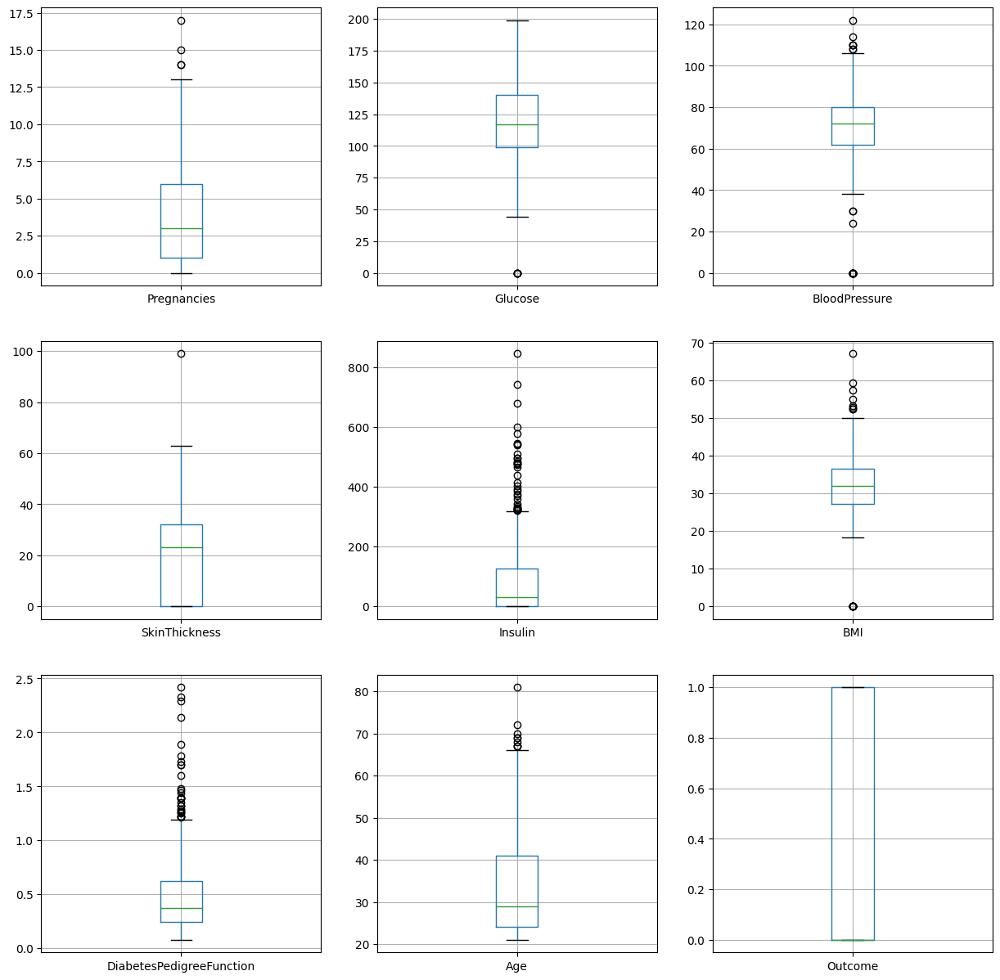

In [18]:
plt.figure(figsize=(15,15))
i=1
for col in diabetes_1.columns:
    plt.subplot(3,3,i)
    diabetes_1[[col]].boxplot()
    i+=1
    
    
plt.savefig('boxplot')


## Ploting the boxplot to check the outliers

In [19]:
diabetes_1.shape

## To get the Shape of the data which we are using

(768, 9)

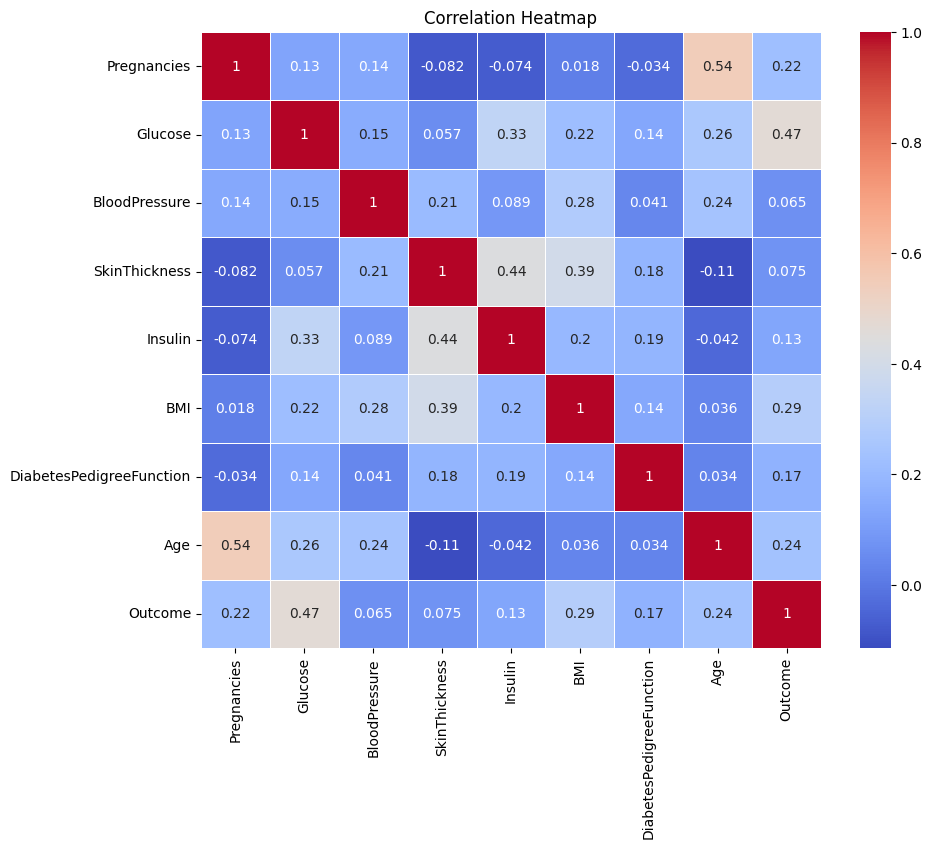

In [20]:
plt.figure(figsize=(10, 8))
sns.heatmap(correlation, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Heatmap')
plt.savefig('heatmap')
plt.show()

## To show the coorelation in the Heatmap in the new data diabetes_1

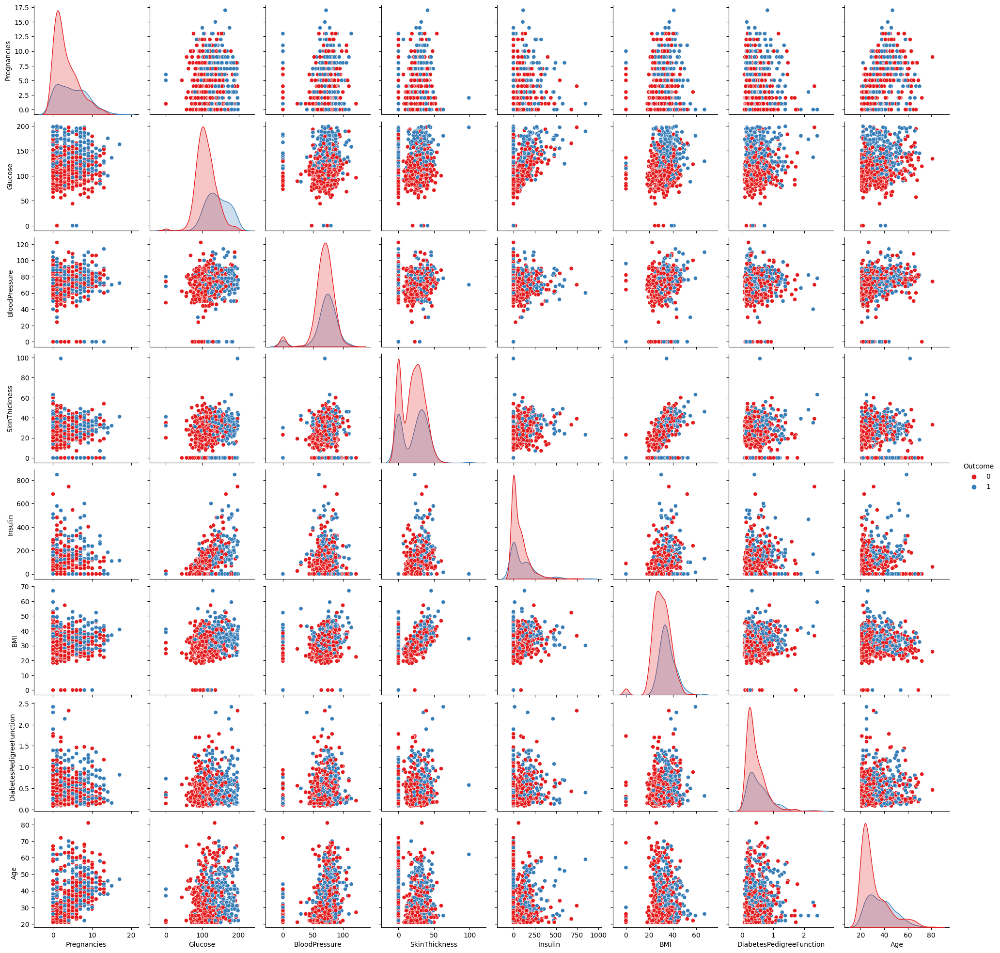

In [21]:
sns.pairplot(diabetes_1, hue = "Outcome",palette="Set1")
plt.savefig('pairplot')
plt.show()

## Pairplot is ploted to show the relationship between the two variables in the new data diabetes_1

0    500
1    268
Name: Outcome, dtype: int64


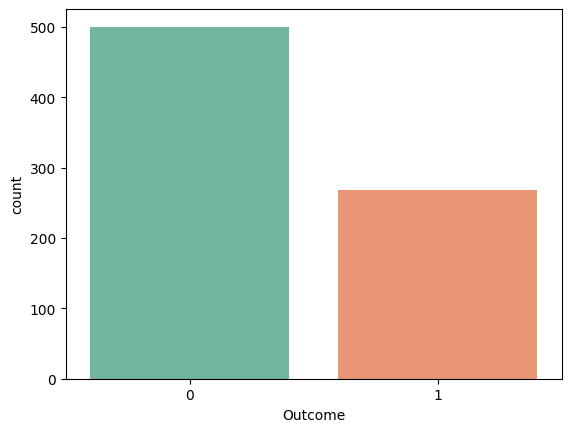

In [22]:
plt.figure()
sns.countplot(diabetes_1.Outcome, palette="Set2")
print(diabetes_1.Outcome.value_counts())


## To count the total number of people with and without diabetes in the dataset

1     135
0     111
2     103
3      75
4      68
5      57
6      50
7      45
8      38
9      28
10     24
11     11
13     10
12      9
14      2
15      1
17      1
Name: Pregnancies, dtype: int64


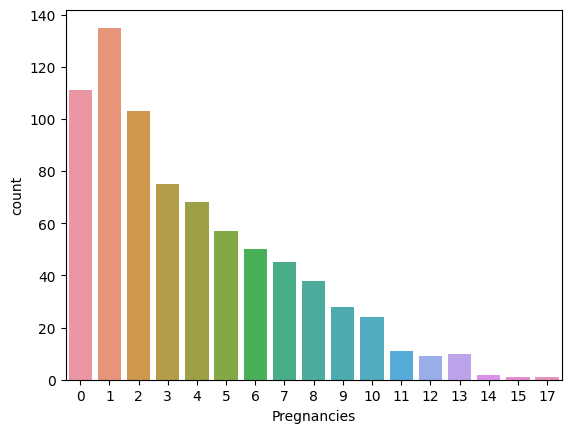

In [23]:
plt.figure()
sns.countplot(diabetes_1["Pregnancies"])
print(diabetes_1["Pregnancies"].value_counts())

## To count and display the pregnancies

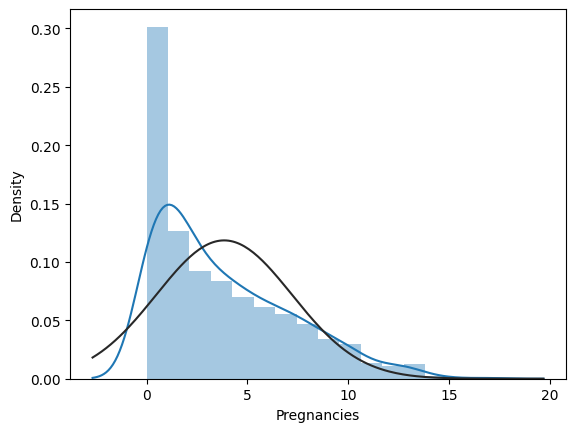

<Figure size 640x480 with 0 Axes>

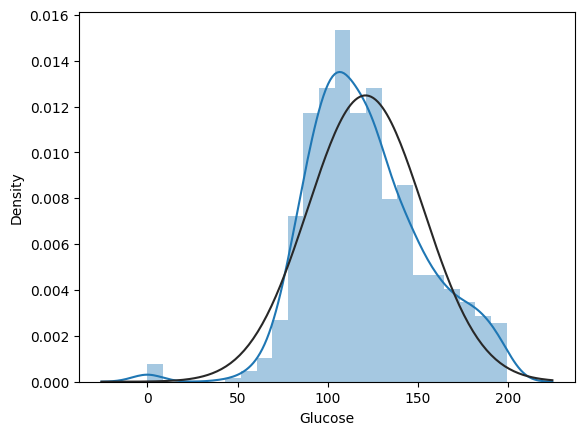

<Figure size 640x480 with 0 Axes>

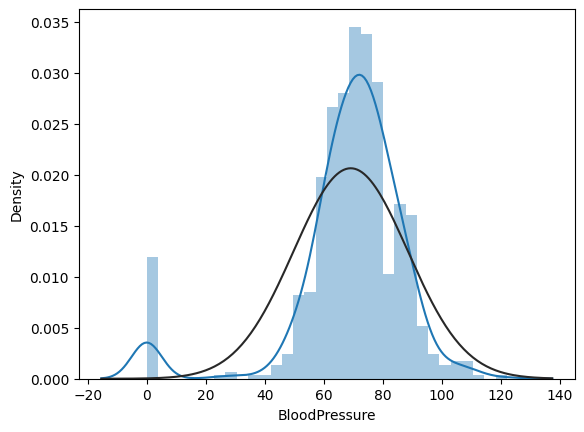

<Figure size 640x480 with 0 Axes>

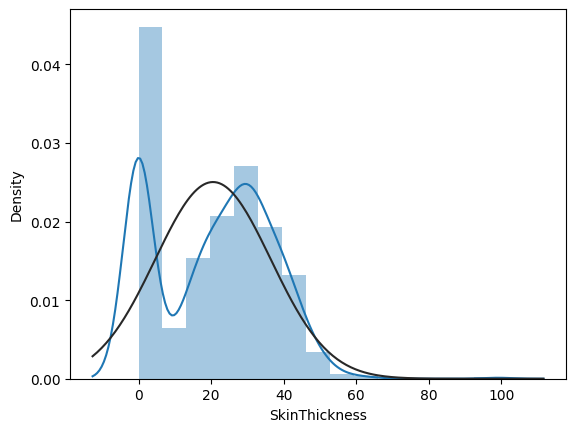

<Figure size 640x480 with 0 Axes>

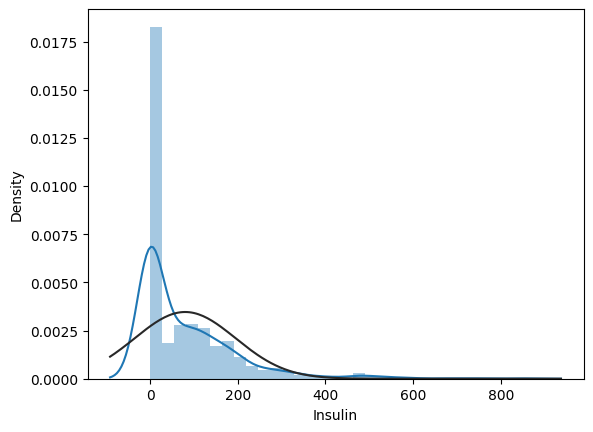

<Figure size 640x480 with 0 Axes>

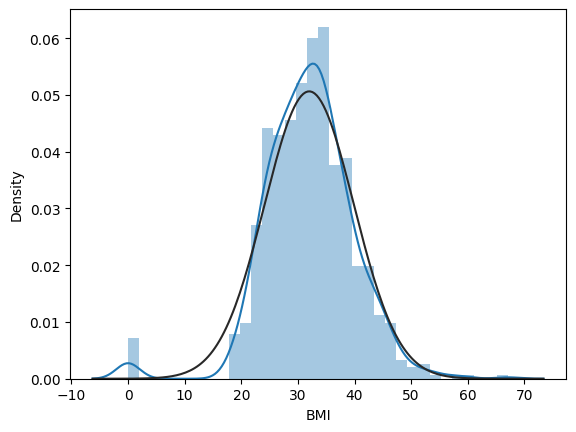

<Figure size 640x480 with 0 Axes>

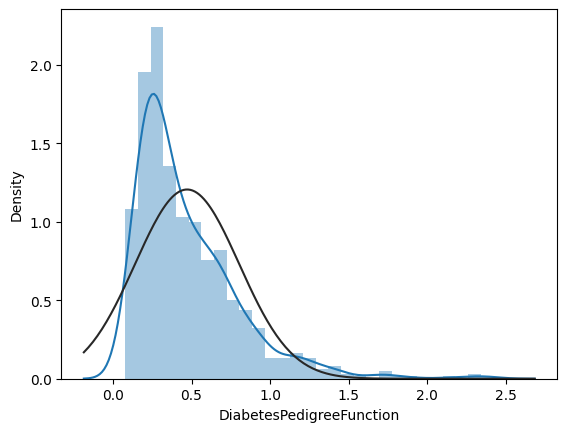

<Figure size 640x480 with 0 Axes>

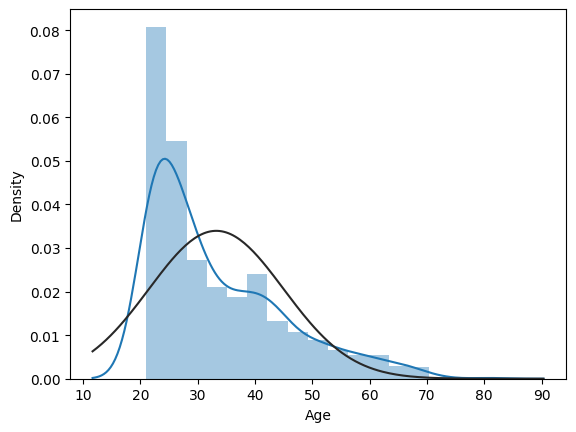

<Figure size 640x480 with 0 Axes>

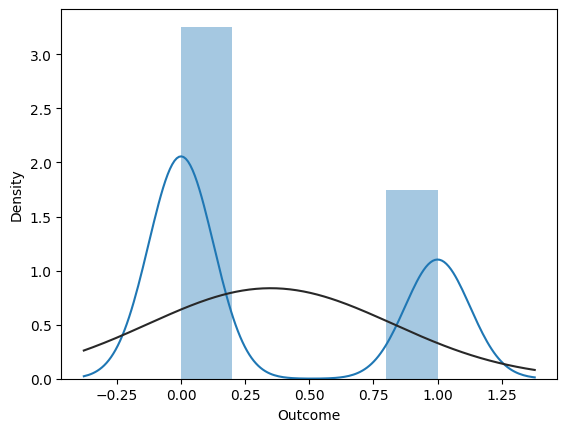

<Figure size 640x480 with 0 Axes>

In [24]:
for i in diabetes_1.columns:
    plt.figure()
    sns.distplot(diabetes_1[i], fit = norm )
    plt.show()
    plt.savefig(f'data dist.png')
    
    
## Histogram is plotted to show how widely the data has been distributed

#### Data Splitting and Normalizing:
- Split the data into training and testing sets (80-20 split).
- Standardized the data using StandardScaler.

In [25]:
x = diabetes_1.drop(["Outcome"], axis = 1)
y = diabetes_1["Outcome"]


## Assigning the values to x and y to start training the data

In [26]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state = 42)


## importing the train_test_split and assigning the data 
## Splitting out the data from the diabetes_1 data set with the 80,20 split

In [27]:
print("x_train shape: ", x_train.shape)
print("x_test shape: ", x_test.shape)
print("y_train shape: ", y_train.shape)
print("y_test shape: ", y_test.shape)


## Printing out the shape of the splitted data

x_train shape:  (614, 8)
x_test shape:  (154, 8)
y_train shape:  (614,)
y_test shape:  (154,)


In [28]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
SSX_train = scaler.fit_transform(x_train)
SSX_test = scaler.transform(x_test)

## importing the StandardScaler and normalising the data 

In [29]:
SSX_train


array([[-0.52639686, -1.15139792, -3.75268255, ..., -4.13525578,
        -0.49073479, -1.03594038],
       [ 1.58804586, -0.27664283,  0.68034485, ..., -0.48916881,
         2.41502991,  1.48710085],
       [-0.82846011,  0.56687102, -1.2658623 , ..., -0.42452187,
         0.54916055, -0.94893896],
       ...,
       [ 1.8901091 , -0.62029661,  0.89659009, ...,  1.76054443,
         1.981245  ,  0.44308379],
       [-1.13052335,  0.62935353, -3.75268255, ...,  1.34680407,
        -0.78487662, -0.33992901],
       [-1.13052335,  0.12949347,  1.43720319, ..., -1.22614383,
        -0.61552223, -1.03594038]])

In [30]:
SSX_test

array([[ 0.68185612, -0.71402038, -0.61712658, ...,  0.26073561,
        -0.11637247,  0.87809089],
       [-0.52639686, -0.27664283,  0.30191569, ...,  0.48053518,
        -0.954231  , -1.03594038],
       [-0.52639686, -0.40160784, -0.29275872, ..., -0.15300476,
        -0.9245197 , -1.03594038],
       ...,
       [ 1.28598261, -0.80774414,  0.13973176, ...,  0.62275843,
         0.04703966,  2.0961108 ],
       [-0.52639686,  0.78555979,  0.03160914, ..., -0.51502758,
        -0.39268751, -0.33992901],
       [ 1.28598261, -1.46381046,  0.03160914, ...,  0.42881763,
         0.70068816,  0.53008521]])

#### Modeling:
- Utilized Decision Tree, Random Forest, and XGBoost classifiers.
- Evaluated model performance using accuracy, precision, recall, F1-score, and confusion matrices.

## Decision Tree

In [31]:
from sklearn.tree import DecisionTreeClassifier
dtree = DecisionTreeClassifier()
dtree.fit(x_train, y_train)
n_nodes=dtree.tree_.node_count
n_nodes
## importing the required modules for decision tree and training the data

207

In [32]:
from sklearn import metrics
dtree_predictions = dtree.predict(x_test)

## importing metrics to check the accuracy of the model

In [33]:
print("Accuracy Score =", format(metrics.accuracy_score(y_test,dtree_predictions)))

## To check the accuracy of the model

Accuracy Score = 0.7467532467532467


In [34]:
from sklearn.metrics import classification_report, confusion_matrix
cm = confusion_matrix(y_test, dtree_predictions)

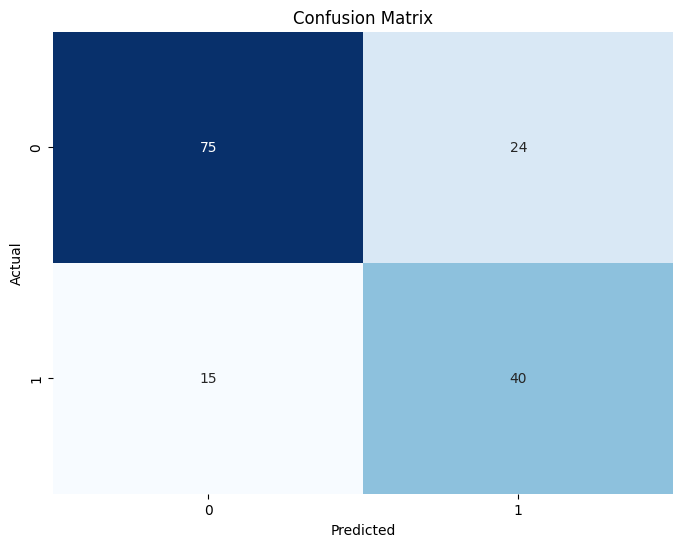

In [35]:
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", cbar=False)
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix")
plt.show()

## To plot the confusion matrix for the decision tree

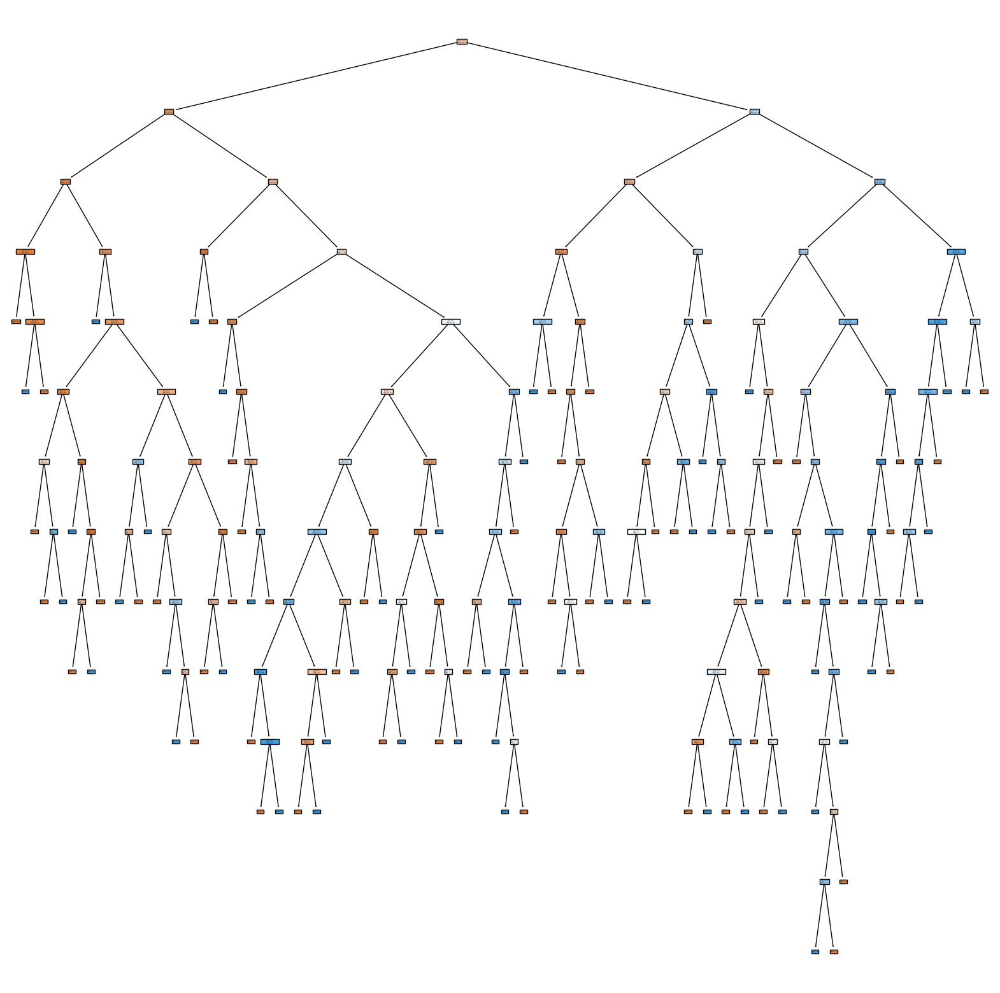

In [36]:
from sklearn import tree
plt.figure(figsize=(20,20))
tree.plot_tree(dtree,filled=True, class_names=[str(i) for i in set(y)] ,feature_names=x.columns)
plt.savefig('dt_model_1')

## To plot the decision model tree map

## Random Forest

In [37]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

rfclassifier = RandomForestClassifier(n_estimators=100)
rfclassifier.fit(x_train,y_train)

## importing the required modules for Random Forest and training the data

RandomForestClassifier()

In [38]:
rfc_train = rfclassifier.predict(x_train)
from sklearn import metrics
print("Accuracy_Score =", format(metrics.accuracy_score(y_train, rfc_train)))

## To print the accuracy of the trained model

Accuracy_Score = 1.0


In [39]:
from sklearn import metrics
predictions = rfclassifier.predict(x_test)
print("Accuracy_Score =", format(metrics.accuracy_score(y_test, predictions)))

## get the Accuracy of the test model

Accuracy_Score = 0.7337662337662337


In [40]:
from sklearn.metrics import classification_report, confusion_matrix
y_pred = rfclassifier.predict(x_test)
cm = confusion_matrix(y_test, y_pred)


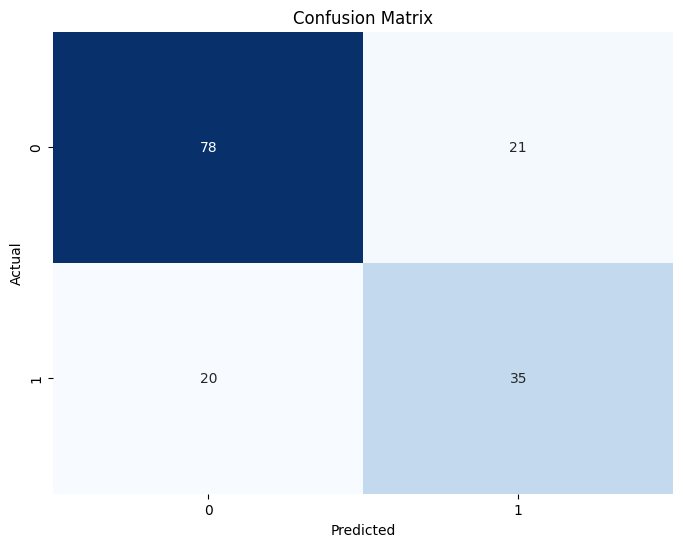

In [41]:
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", cbar=False)
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix")
plt.show()

## To plot the confusion matrix for the Random forest

In [42]:
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy :", accuracy)
precision = precision_score(y_test, y_pred)
print("Precision :", precision)
recall = recall_score(y_test, y_pred)
print("Recall :", recall)
F1_score = f1_score(y_test, y_pred)
print("F1-score :", F1_score)


Accuracy : 0.7337662337662337
Precision : 0.625
Recall : 0.6363636363636364
F1-score : 0.6306306306306306


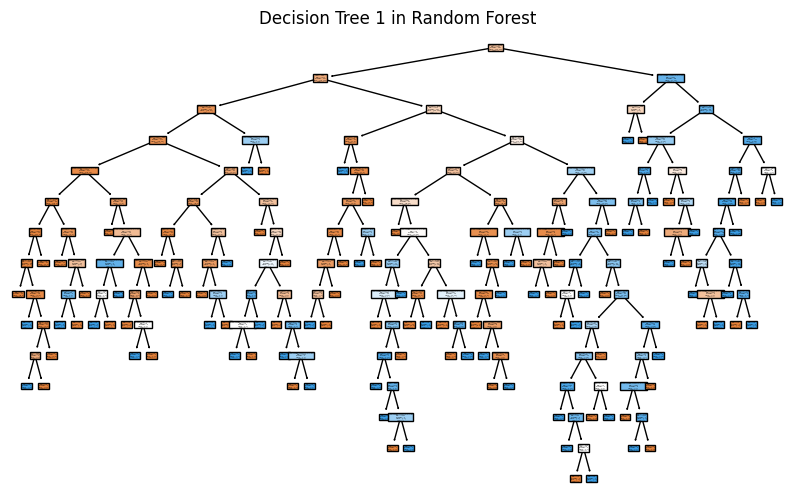

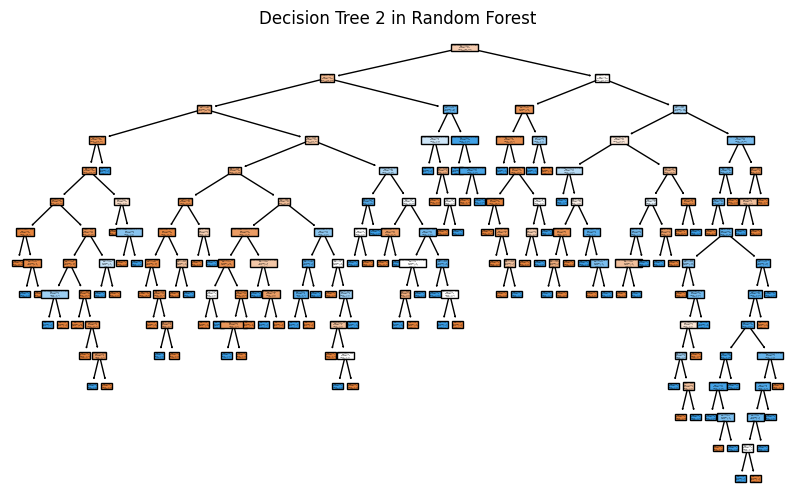

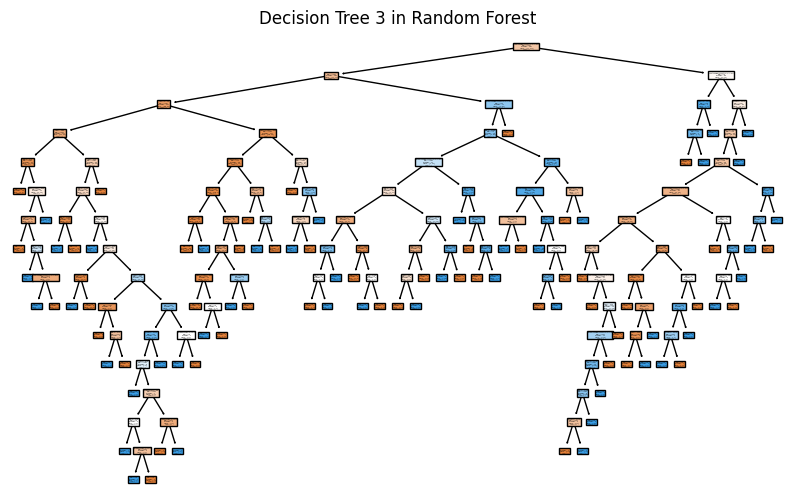

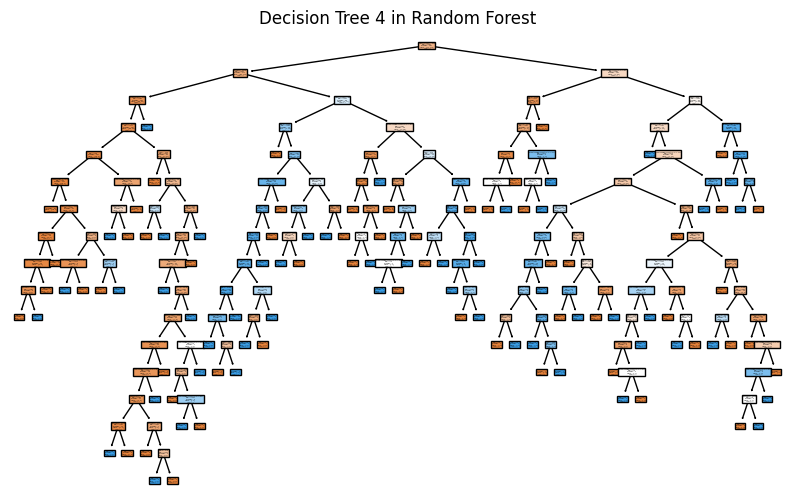

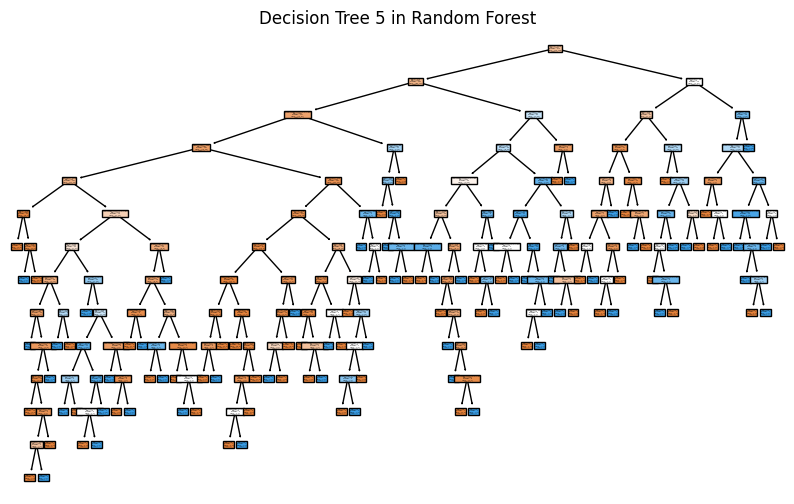

...

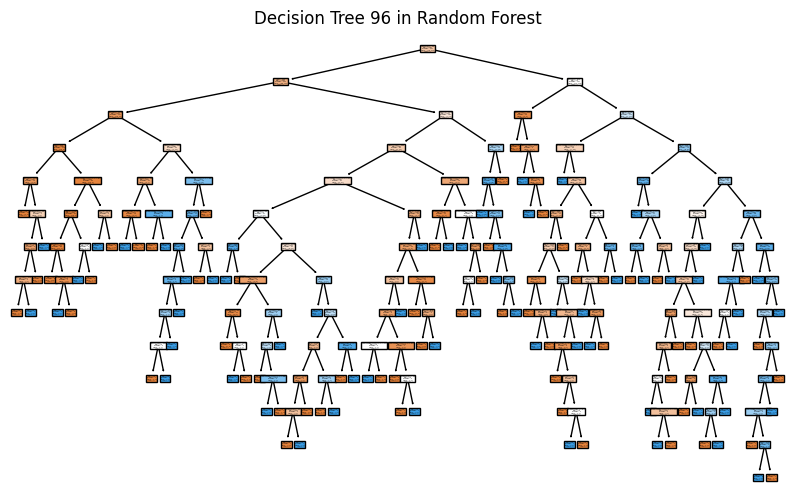

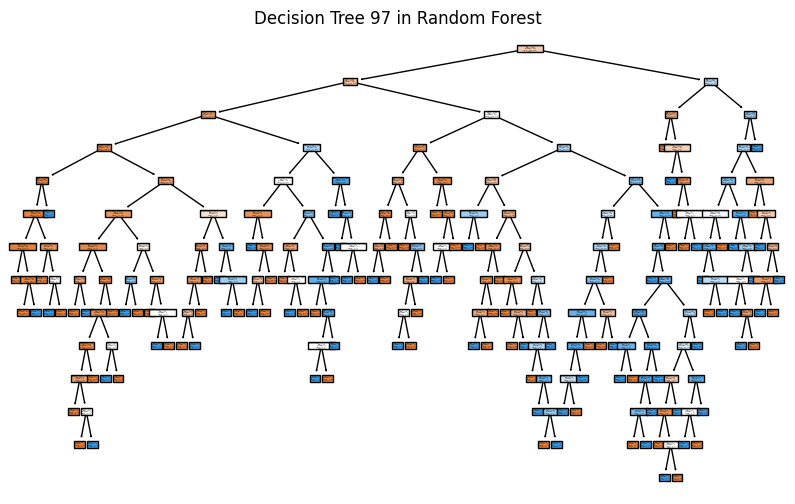

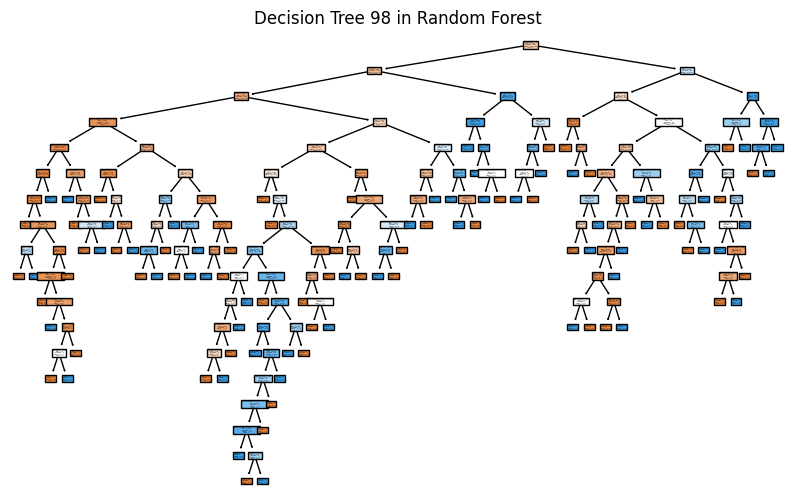

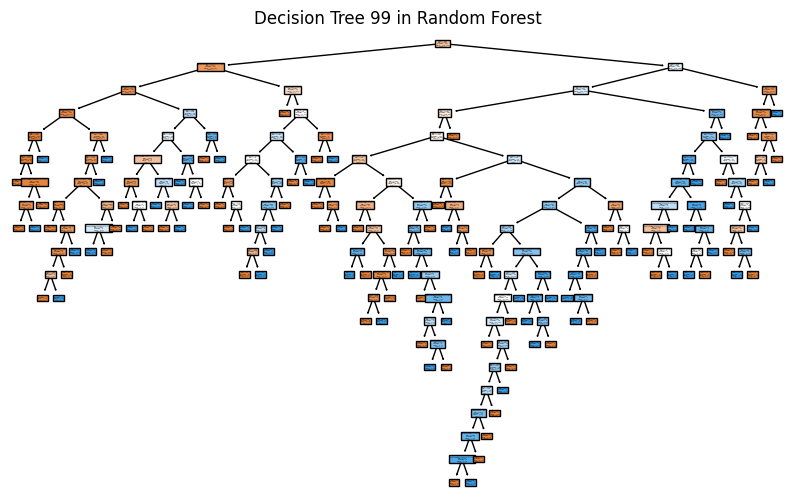

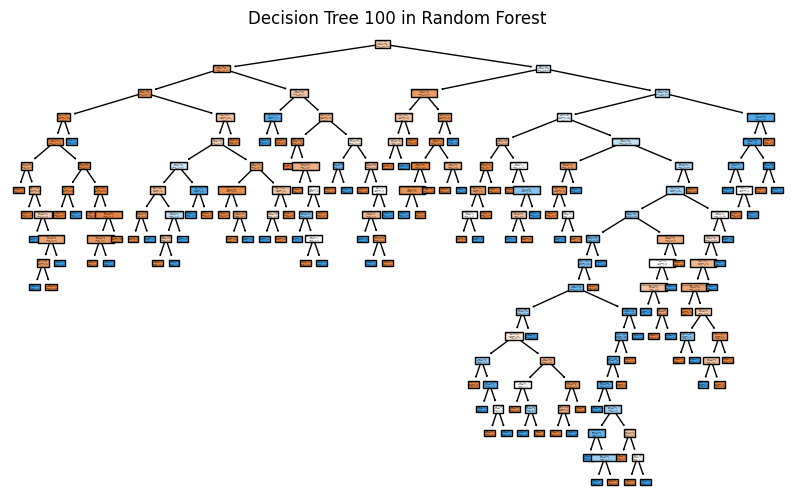

In [43]:
for i, tree_in_forest in enumerate(rfclassifier.estimators_):
    plt.figure(figsize=(10, 6))
    tree.plot_tree(tree_in_forest, filled=True, class_names=[str(j) for j in set(y)],
                   feature_names=x.columns)
    plt.title(f"Decision Tree {i + 1} in Random Forest")
    plt.savefig(f'decision_tree_{i + 1}.png')  
    plt.show()
    
## To plot the random forest tree map

## XG boost

In [44]:
import xgboost as xgb
from xgboost import XGBClassifier
xgb_classifier = XGBClassifier(n_estimators=100, random_state=42)
xgb_classifier.fit(x_train, y_train)

## importing the required modules for xgboost and training the data

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=100, n_jobs=None,
              num_parallel_tree=None, random_state=42, ...)

In [45]:
from sklearn import metrics
xgb_pred = xgb_classifier.predict(x_test)
print("Accuracy Score =", format(metrics.accuracy_score(y_test, xgb_pred)))

## To get the accuracy od the model

Accuracy Score = 0.7077922077922078


In [46]:
cm = confusion_matrix(y_test, y_pred)


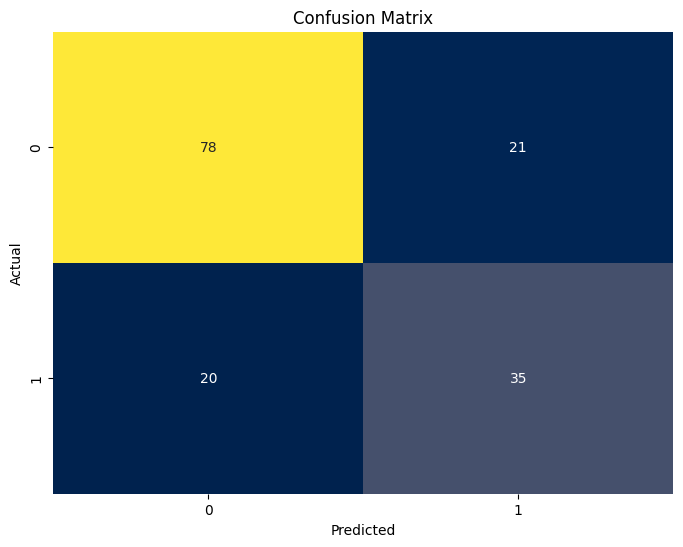

In [47]:
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt="d", cmap="cividis", cbar=False)
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix")
plt.show()

## To plot the confusion matrix for the XG-Boost

## To Compare the Accuracy of the 3 Different Models

In [48]:
xgb_pred = xgb_classifier.predict(x_test)
dtree_predictions = dtree.predict(x_test)
rfc_pred = rfclassifier.predict(x_test)

In [49]:
dt_accuracy = accuracy_score(y_test,dtree_predictions)
rf_accuracy = accuracy_score(y_test, predictions)
xgb_accuracy = accuracy_score(y_test, xgb_pred)

## Calculate accuracies

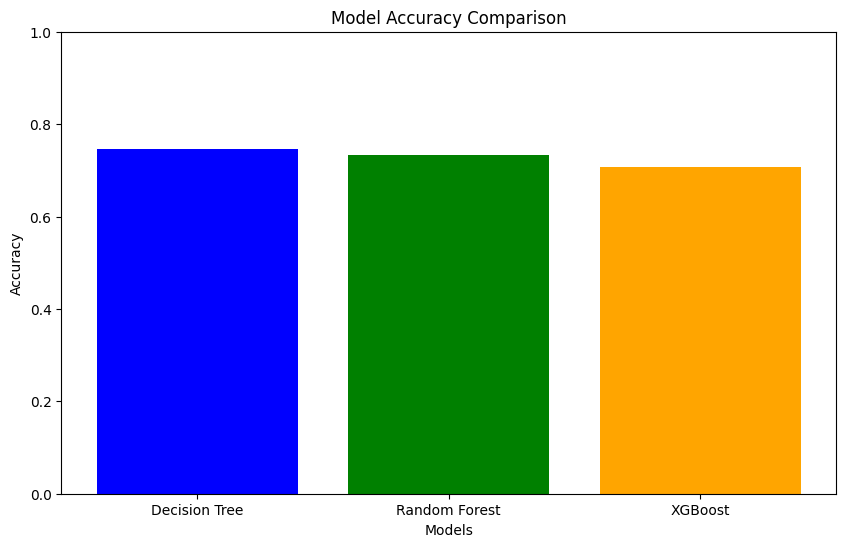

<Figure size 640x480 with 0 Axes>

In [50]:
models = ['Decision Tree', 'Random Forest', 'XGBoost']
accuracies = [dt_accuracy, rf_accuracy, xgb_accuracy]

plt.figure(figsize=(10, 6))
plt.bar(models, accuracies, color=['blue', 'green', 'orange'])
plt.xlabel('Models')
plt.ylabel('Accuracy')
plt.title('Model Accuracy Comparison')
plt.ylim([0, 1])  
plt.show()
plt.savefig('cmp')

## To compare the accuracy of the 3 different models